In [1]:
!pip install --extra-index-url https://pypi.anaconda.org/scipy-wheels-nightly/simple imagecodecs

Looking in indexes: https://pypi.org/simple, https://pypi.anaconda.org/scipy-wheels-nightly/simple


In [1]:
import os
import numpy as np
import torch
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
from torchvision.transforms import v2
from torchvision import tv_tensors
import tifffile as tiff
from PIL import Image
import cv2

In [3]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [4]:
print(os.listdir("./drive/MyDrive/dataset"))

['input', 'DIC-C2DH-HeLa-test', 'DIC-C2DH-HeLa-train']


In [5]:
import sys
sys.path.append('/content/drive/MyDrive/')


In [2]:
from loss_functions import soft_dice, soft_iou, hard_dice, hard_iou, combined_loss

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"using device: {device}")

using device: cpu


In [4]:
random_seed = 42
torch.manual_seed(random_seed)

In [5]:
class CellDataset(Dataset):
    def __init__(self, image_dir, mask_dir=None, transforms=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transforms = transforms
        self.kernel = np.ones((3,3), np.uint8)
        self.image_files = sorted(os.listdir(image_dir))

        if mask_dir is not None:
            self.mask_files = sorted(os.listdir(mask_dir))


            self.frame_ids = [
                f.split('.')[0][-3:] for f in self.mask_files
            ]
        else:
            self.mask_files = None
            self.frame_ids = None   

    def __len__(self):
        if self.mask_dir is None:
            return len(self.image_files)     
        return len(self.mask_files)          

    def load_tiff_norm(self, path):
        with Image.open(path) as img:
          img = img.convert("L")
          img = np.array(img, dtype=np.float32)
        max_val = img.max()
        if max_val > 0:
            img = img / max_val
        return img

    def __getitem__(self, idx):

 
        if self.mask_dir is None:
            image_name = self.image_files[idx]
            image_path = os.path.join(self.image_dir, image_name)

            image = self.load_tiff_norm(image_path)
            image = torch.from_numpy(image).unsqueeze(0)
            image = tv_tensors.Image(image)

            if self.transforms:
                image = self.transforms(image)

            return image

        frame_id = self.frame_ids[idx]        

        image_path = os.path.join(self.image_dir, f"t{frame_id}.tif")
        image = self.load_tiff_norm(image_path)
        image = torch.from_numpy(image).unsqueeze(0)
        image = tv_tensors.Image(image)


        mask_path = os.path.join(self.mask_dir, f"man_seg{frame_id}.tif")

        with Image.open(mask_path) as mask:
          mask = mask.convert("L")
          mask = np.array(mask, dtype=np.float32)
          instance_mask = mask.copy()

        mask = (mask > 0).astype(np.float32)

        instance_mask_eroded = cv2.erode(instance_mask, self.kernel)
        instance_mask = instance_mask - instance_mask_eroded
        instance_mask[instance_mask > 0] = 1
        instance_mask = instance_mask.astype(np.float32)

        mask = torch.from_numpy(mask).unsqueeze(0)
        mask = tv_tensors.Mask(mask)

        instance_mask = torch.from_numpy(instance_mask).unsqueeze(0)
        instance_mask = tv_tensors.Mask(instance_mask)

        target = {"masks": [mask, instance_mask]}


        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target["masks"][0], target["masks"][1]


In [6]:
transforms = v2.Compose([
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomVerticalFlip(p=0.5),
    v2.GaussianBlur(kernel_size=3),
    v2.ElasticTransform(alpha=50.0, sigma=10),
    v2.RandomRotation(degrees=(0,180)),
    v2.ToDtype(torch.float32),
    v2.Normalize(mean=[0], std=[1])
])

test_transform = v2.Compose([
    v2.ToDtype(dtype=torch.float32),
    v2.Normalize(mean=[0], std=[1])
])


In [7]:
def get_train_loaders(image_path, mask_path, batch_size = 1, shuffle=True, transforms=None):

    dataset = CellDataset(image_dir = image_path, mask_dir = mask_path, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)

def get_test_loaders(image_path, batch_size = 1, shuffle=False, transforms=None):
    dataset = CellDataset(image_dir=image_path, mask_dir=None, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)


In [12]:
train_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01"

train_masks = [
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_GT/SEG",
              ]

pretrain_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[0], batch_size=1, shuffle=True, transforms=transforms)
finetune_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[1], batch_size=1, shuffle=True, transforms=transforms)


val_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02"
val_masks = [ "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_GT/SEG",
              ]

val_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[0], batch_size=1, shuffle=False, transforms=test_transform)
test_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[1], batch_size=1, shuffle=False, transforms=test_transform)

test_path = [
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/01",
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/02",
             ]

final_test_loader_01 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)
final_test_loader_02 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)

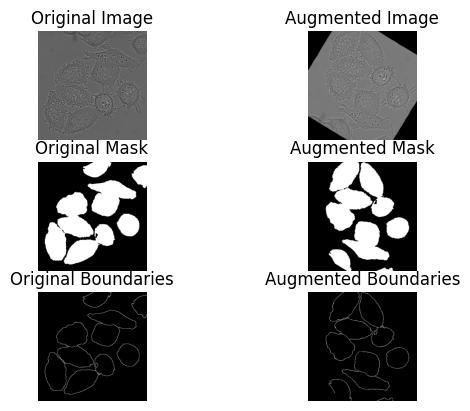

In [13]:
dataset = CellDataset(image_dir=train_path, mask_dir=train_masks[0], transforms=None)
img1, mask1, im1 = dataset[3]
torch.manual_seed(0)
img2, out = transforms(img1, {"masks": [mask1, im1]})
mask2 = out["masks"][0]
im2 = out["masks"][1]

plt.subplot(3,2,1); plt.imshow(img1.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Original Image");
plt.subplot(3,2,2); plt.imshow(img2.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Augmented Image");
plt.subplot(3,2,3); plt.imshow(mask1.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Original Mask");
plt.subplot(3,2,4); plt.imshow(mask2.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Augmented Mask");
plt.subplot(3,2,5); plt.imshow(im1.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Original Boundaries");
plt.subplot(3,2,6); plt.imshow(im2.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Augmented Boundaries");
plt.show()

In [14]:
import torch.nn as nn
import torch.functional as F
from torchvision.models import resnet34, ResNet34_Weights
from torchsummary import summary

In [17]:
class UpBlock(nn.Module):
    def __init__(self, in_ch, skip_ch, out_ch):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_ch, out_ch, 2, stride=2)
        self.conv = nn.Sequential(
            nn.Conv2d(out_ch + skip_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x, skip):
        x = self.up(x)
        x = torch.cat([x, skip], dim=1)
        return self.conv(x)

In [ ]:
class SelfAttention(nn.Module):
    def __init__(self, in_ch, num_heads=1):
        super().__init__()

        self.num_heads = num_heads
        self.head_dims = in_ch // num_heads
        
        self.query = nn.Conv2d(in_ch, in_ch, 1)
        self.key = nn.Conv2d(in_ch, in_ch, 1)
        self.value = nn.Conv2d(in_ch, in_ch, 1)

        self.gamma = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        B, C, H, W = x.shape
        N = H * W

        Q = self.query(x).view(B, self.num_heads, self.head_dims, N)
        K = self.key(x).view(B, self.num_heads, self.head_dims, N)
        V = self.value(x).view(B, self.num_heads, self.head_dims, N)

        attn = torch.einsum("bhcn, bhcm->bhnm", Q, K)
        attn = attn / (self.head_dims ** 0.5)
        attn = torch.softmax(attn, dim=-1)
        
        out = torch.einsum("bhnm, bhcm->bhcn", attn, V)
        out = out.reshape(B, C, H, W)
        return self.gamma * out + x


In [ ]:
class Encoder(nn.Module):
    def __init__(self, in_ch=1):
        super().__init__()

        backbone = resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)


        weight = backbone.conv1.weight.data.mean(dim=1, keepdim=True)
        conv_gray = nn.Conv2d(in_ch, 64, kernel_size=7, stride=2, padding=3, bias=False)
        conv_gray.weight.data = weight

        backbone.conv1 = conv_gray

        self.layer0 = nn.Sequential(backbone.conv1, backbone.bn1, backbone.relu)
        self.maxpool = backbone.maxpool
        self.layer1  = backbone.layer1
        self.layer2  = backbone.layer2
        self.layer3  = backbone.layer3
        self.layer4  = backbone.layer4

    def forward(self, x):
        x0 = self.layer0(x)
        x1 = self.layer1(self.maxpool(x0))
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)
        return x0, x1, x2, x3, x4



In [20]:
class Decoder(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.self_attention = SelfAttention(512)

        self.up4 = UpBlock(512, 256, 256)
        self.up3 = UpBlock(256, 128, 128)
        self.up2 = UpBlock(128, 64, 64)
        self.up1 = UpBlock(64, 64, 64)

        self.final = nn.Conv2d(64, num_classes, kernel_size=1)

    def forward(self, x0, x1, x2, x3, x4, orig_size):
        x4 = self.self_attention(x4)

        d4 = self.up4(x4, x3)
        d3 = self.up3(d4, x2)
        d2 = self.up2(d3, x1)
        d1 = self.up1(d2, x0)

        out = nn.functional.interpolate(d1, size=orig_size, mode='bilinear')
        return self.final(out)



In [21]:
class UNet(nn.Module):
    def __init__(self, in_ch=1, num_classes=1):
        super().__init__()
        self.encoder = Encoder(in_ch=in_ch)
        self.num_classes = num_classes
        self.decoder = Decoder(num_classes)


    def freeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = False

    def unfreeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = True

    def forward(self, x):
        orig_size = x.shape[2:]
        x0, x1, x2, x3, x4 = self.encoder(x)
        return self.decoder(x0, x1, x2, x3, x4, orig_size)

In [22]:
model = UNet(in_ch=1, num_classes=2)

In [23]:
model.to(device);
model.freeze_encoder()
summary(model, (1,512,512))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           3,136
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
         MaxPool2d-4         [-1, 64, 128, 128]               0
            Conv2d-5         [-1, 64, 128, 128]          36,864
       BatchNorm2d-6         [-1, 64, 128, 128]             128
              ReLU-7         [-1, 64, 128, 128]               0
            Conv2d-8         [-1, 64, 128, 128]          36,864
       BatchNorm2d-9         [-1, 64, 128, 128]             128
             ReLU-10         [-1, 64, 128, 128]               0
       BasicBlock-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]          36,864
      BatchNorm2d-13         [-1, 64, 128, 128]             128
             ReLU-14         [-1, 64, 1

In [24]:
def checkpoint(model, filename):
    torch.save(model.state_dict(), filename)

def resume(model, path, device="cpu"):
    ckpt = torch.load(path, map_location=device)

    if "model_state_dict" in ckpt:
        model.load_state_dict(ckpt["model_state_dict"])
    elif "model" in ckpt:
        model.load_state_dict(ckpt["model"])
    else:
        model.load_state_dict(ckpt)

    print("Checkpoint loaded successfully.")
    return model


In [25]:
from tqdm.auto import tqdm

In [ ]:
def train(model, epoch, train, dataloader, optimizer, device, BCE, dice_score=soft_dice, iou_score=soft_iou):

    model.train()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0

    bce_boundary_loss_fn = nn.BCEWithLogitsLoss(
        pos_weight=torch.tensor([25.0]).to(device)
    )

    for Image, Mask, Boundary in tqdm(dataloader):
        X = Image.to(device)
        mask = Mask.to(device).float()
        boundary = Boundary.to(device).float()

        optimizer.zero_grad()

        logits = model(X)

        mask_logits, boundary_logits = logits[:,0:1, :, :], logits[:,1:2, :, :]


        if train == "Finetune":
            loss = BCE(mask_logits, mask) + (1 - dice_score(mask_logits, mask))
        else:
            loss = combined_loss(logits=mask_logits, targets=mask, bce_loss=BCE, alpha=0.3)
        boundary_loss = bce_boundary_loss_fn(boundary_logits, boundary)
        loss = loss + 0.5 * boundary_loss
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

        with torch.no_grad():
            dice_val = dice_score(mask_logits.detach(),mask).item()
            iou_val  = iou_score(mask_logits.detach(), mask).item()

            total_dice += dice_val
            total_iou  += iou_val

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(f"{train} Epoch {epoch} | "
          f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}")

    return avg_loss, avg_dice, avg_iou


In [ ]:
def test(
    model,
    dataloader,
    device,
    BCE,
    epoch,
    dice_score=hard_dice,
    iou_score=hard_iou,
    mode="Test"
):
    model.eval()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0
    bce_boundary_loss_fn = nn.BCEWithLogitsLoss(
        pos_weight=torch.tensor([25.0]).to(device)
    )
    with torch.inference_mode():
        for images, masks, boundaries in tqdm(dataloader):
            images = images.to(device)
            masks = masks.to(device).float()
            boundaries = boundaries.to(device).float()

            logits = model(images)

            mask_logits, boundary_logits = logits[:,0:1, :, :], logits[:,1:2, :, :]

            dice_val = dice_score(mask_logits, masks)
            loss = BCE(mask_logits, masks) + (1 - dice_val)
            boundary_loss = bce_boundary_loss_fn(boundary_logits, boundaries)
            loss = loss + 0.5 * boundary_loss

            total_loss += loss.item()
            total_dice += dice_val.item()
            total_iou  += iou_score(mask_logits, masks).item()

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(
        f"{mode} Epoch: {epoch} | "
        f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}"
    )

    return avg_loss, avg_dice, avg_iou


In [28]:
pretrain_train_losses = []
pretrain_dice_scores = []
pretrain_iou_scores = []

pretrain_val_train_losses = []
pretrain_val_dice_scores = []
pretrain_val_iou_scores = []

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Pre-Train", dataloader=pretrain_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    pretrain_train_losses.append(tr_loss)
    pretrain_dice_scores.append(tr_dice_score)
    pretrain_iou_scores.append(tr_iou_score)

    pretrain_val_train_losses.append(val_loss)
    pretrain_val_dice_scores.append(val_dice_score)
    pretrain_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = (val_dice_score + val_iou_score) / 2
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/pretrain_best_model_with_boundary.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Pre-training best model from epoch: {best_epoch}, Best Score: {best_score}")

  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 1 | Loss: 0.9780 | Dice: 0.5993 | IoU: 0.4363


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 1.0334 | Dice: 0.8495 | IoU: 0.7388
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 2 | Loss: 0.6513 | Dice: 0.8248 | IoU: 0.7029


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.9127 | Dice: 0.8674 | IoU: 0.7664
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 3 | Loss: 0.5683 | Dice: 0.8546 | IoU: 0.7467


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.8083 | Dice: 0.8848 | IoU: 0.7940
********************
Model Checkpointed at Best Epoch: 3


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 4 | Loss: 0.5268 | Dice: 0.8699 | IoU: 0.7703


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.9430 | Dice: 0.8473 | IoU: 0.7357
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 5 | Loss: 0.5050 | Dice: 0.8796 | IoU: 0.7854


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.7843 | Dice: 0.8959 | IoU: 0.8119
********************
Model Checkpointed at Best Epoch: 5


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 6 | Loss: 0.4847 | Dice: 0.8862 | IoU: 0.7960


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.8907 | Dice: 0.8694 | IoU: 0.7695
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 7 | Loss: 0.4680 | Dice: 0.8939 | IoU: 0.8085


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.6975 | Dice: 0.9146 | IoU: 0.8430
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 8 | Loss: 0.4440 | Dice: 0.9026 | IoU: 0.8227


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.6870 | Dice: 0.9154 | IoU: 0.8443
********************
Model Checkpointed at Best Epoch: 8


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 9 | Loss: 0.4300 | Dice: 0.9066 | IoU: 0.8295


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.6489 | Dice: 0.9225 | IoU: 0.8564
********************
Model Checkpointed at Best Epoch: 9


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 10 | Loss: 0.4150 | Dice: 0.9111 | IoU: 0.8370


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.7337 | Dice: 0.9138 | IoU: 0.8416
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 11 | Loss: 0.4099 | Dice: 0.9147 | IoU: 0.8431


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.9024 | Dice: 0.8824 | IoU: 0.7901
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 12 | Loss: 0.4014 | Dice: 0.9160 | IoU: 0.8453


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.6984 | Dice: 0.9153 | IoU: 0.8441
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 13 | Loss: 0.3927 | Dice: 0.9191 | IoU: 0.8506


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.7904 | Dice: 0.9014 | IoU: 0.8209
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 14 | Loss: 0.3861 | Dice: 0.9213 | IoU: 0.8544


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.6580 | Dice: 0.9231 | IoU: 0.8575
********************
Model Checkpointed at Best Epoch: 14


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 15 | Loss: 0.3805 | Dice: 0.9227 | IoU: 0.8568


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.6347 | Dice: 0.9227 | IoU: 0.8568
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 16 | Loss: 0.3697 | Dice: 0.9259 | IoU: 0.8622


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.6281 | Dice: 0.9251 | IoU: 0.8609
********************
Model Checkpointed at Best Epoch: 16


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 17 | Loss: 0.3703 | Dice: 0.9248 | IoU: 0.8604


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.6720 | Dice: 0.9166 | IoU: 0.8463
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 18 | Loss: 0.3651 | Dice: 0.9271 | IoU: 0.8643


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.6060 | Dice: 0.9306 | IoU: 0.8705
********************
Model Checkpointed at Best Epoch: 18


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 19 | Loss: 0.3616 | Dice: 0.9275 | IoU: 0.8650


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.6079 | Dice: 0.9274 | IoU: 0.8648
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 20 | Loss: 0.3586 | Dice: 0.9278 | IoU: 0.8657


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 0.5937 | Dice: 0.9300 | IoU: 0.8694
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 21 | Loss: 0.3521 | Dice: 0.9301 | IoU: 0.8697


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.6323 | Dice: 0.9272 | IoU: 0.8646
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 22 | Loss: 0.3522 | Dice: 0.9295 | IoU: 0.8686


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.6409 | Dice: 0.9219 | IoU: 0.8554
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 23 | Loss: 0.3485 | Dice: 0.9298 | IoU: 0.8692


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.6012 | Dice: 0.9304 | IoU: 0.8702
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 24 | Loss: 0.3517 | Dice: 0.9297 | IoU: 0.8689


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 0.5680 | Dice: 0.9342 | IoU: 0.8769
********************
Model Checkpointed at Best Epoch: 24


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 25 | Loss: 0.3460 | Dice: 0.9316 | IoU: 0.8722


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.5829 | Dice: 0.9311 | IoU: 0.8715
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 26 | Loss: 0.3468 | Dice: 0.9307 | IoU: 0.8707


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 0.5561 | Dice: 0.9344 | IoU: 0.8771
********************
Model Checkpointed at Best Epoch: 26


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 27 | Loss: 0.3499 | Dice: 0.9300 | IoU: 0.8695


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.6208 | Dice: 0.9260 | IoU: 0.8625
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 28 | Loss: 0.3405 | Dice: 0.9327 | IoU: 0.8741


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 0.5890 | Dice: 0.9263 | IoU: 0.8631
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 29 | Loss: 0.3385 | Dice: 0.9326 | IoU: 0.8739


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 0.5794 | Dice: 0.9312 | IoU: 0.8716
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 30 | Loss: 0.3330 | Dice: 0.9343 | IoU: 0.8770


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 0.6083 | Dice: 0.9279 | IoU: 0.8658
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 31 | Loss: 0.3289 | Dice: 0.9351 | IoU: 0.8783


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.6749 | Dice: 0.9236 | IoU: 0.8584
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 32 | Loss: 0.3344 | Dice: 0.9340 | IoU: 0.8764


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 0.7180 | Dice: 0.9174 | IoU: 0.8480
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 33 | Loss: 0.3314 | Dice: 0.9351 | IoU: 0.8785


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.6118 | Dice: 0.9255 | IoU: 0.8617
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 34 | Loss: 0.3290 | Dice: 0.9353 | IoU: 0.8788


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 34 | Loss: 0.6600 | Dice: 0.9227 | IoU: 0.8569
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 35 | Loss: 0.3300 | Dice: 0.9353 | IoU: 0.8787


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 35 | Loss: 0.6132 | Dice: 0.9250 | IoU: 0.8608
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 36 | Loss: 0.3330 | Dice: 0.9343 | IoU: 0.8770


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 36 | Loss: 0.6441 | Dice: 0.9149 | IoU: 0.8436
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 37 | Loss: 0.3283 | Dice: 0.9356 | IoU: 0.8792


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 37 | Loss: 0.5353 | Dice: 0.9364 | IoU: 0.8807
********************
Model Checkpointed at Best Epoch: 37


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 38 | Loss: 0.3268 | Dice: 0.9359 | IoU: 0.8798


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 38 | Loss: 0.5513 | Dice: 0.9365 | IoU: 0.8810
********************
Model Checkpointed at Best Epoch: 38


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 39 | Loss: 0.3225 | Dice: 0.9367 | IoU: 0.8812


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 39 | Loss: 0.6523 | Dice: 0.9214 | IoU: 0.8547
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 40 | Loss: 0.3215 | Dice: 0.9374 | IoU: 0.8824


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 40 | Loss: 0.6280 | Dice: 0.9281 | IoU: 0.8662
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 41 | Loss: 0.3232 | Dice: 0.9368 | IoU: 0.8814


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 41 | Loss: 0.6555 | Dice: 0.9185 | IoU: 0.8497
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 42 | Loss: 0.3237 | Dice: 0.9367 | IoU: 0.8812


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 42 | Loss: 0.6496 | Dice: 0.9195 | IoU: 0.8516
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 43 | Loss: 0.3223 | Dice: 0.9378 | IoU: 0.8831


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 43 | Loss: 0.5910 | Dice: 0.9266 | IoU: 0.8635
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 44 | Loss: 0.3183 | Dice: 0.9389 | IoU: 0.8851


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 44 | Loss: 0.6500 | Dice: 0.9223 | IoU: 0.8562
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 45 | Loss: 0.3151 | Dice: 0.9394 | IoU: 0.8860


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 45 | Loss: 0.5907 | Dice: 0.9302 | IoU: 0.8698
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 46 | Loss: 0.3190 | Dice: 0.9384 | IoU: 0.8842


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 46 | Loss: 0.6492 | Dice: 0.9248 | IoU: 0.8605
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 47 | Loss: 0.3190 | Dice: 0.9381 | IoU: 0.8837


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 47 | Loss: 0.6562 | Dice: 0.9282 | IoU: 0.8663
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 48 | Loss: 0.3202 | Dice: 0.9374 | IoU: 0.8825


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 48 | Loss: 0.6359 | Dice: 0.9228 | IoU: 0.8571
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 49 | Loss: 0.3200 | Dice: 0.9374 | IoU: 0.8825


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 49 | Loss: 0.5925 | Dice: 0.9276 | IoU: 0.8653
********************
Early Stopped Training at Epoch: 49
Pre-training best model from epoch: 37, Best Score: 0.908750409881274


In [29]:
model = UNet(in_ch=1, num_classes=2)
model = resume(model=model, path="drive/MyDrive/models/pretrain_best_model_with_boundary.pth", device=device)
print(f"Loaded Model from Epoch: {best_epoch}")

Checkpoint loaded successfully.
Loaded Model from Epoch: 37


In [30]:
model.unfreeze_encoder()
model.to(device);
encoder = []
decoder = []

for param in model.encoder.parameters():
    encoder.append(param)

for param in model.decoder.parameters():
    decoder.append(param)

optimizer = torch.optim.Adam([
    {"params": encoder, "lr": 1e-5},
    {"params": decoder, "lr": 1e-4}
])

In [31]:
finetune_train_losses = []
finetune_dice_scores = []
finetune_iou_scores = []

finetune_val_train_losses = []
finetune_val_dice_scores = []
finetune_val_iou_scores = []

loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

# Explicitly ensure the problematic conv_gray layer is on the correct device
# This addresses the RuntimeError: Input type (torch.cuda.FloatTensor) and weight type (torch.FloatTensor) should be the same
# which likely occurs due to the direct assignment to .weight.data in the Encoder's __init__.
if hasattr(model.encoder, 'layer0') and isinstance(model.encoder.layer0, nn.Sequential) and len(model.encoder.layer0) > 0:
    if hasattr(model.encoder.layer0[0], 'weight'):
        model.encoder.layer0[0].to(device)

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Finetune", dataloader=finetune_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    finetune_train_losses.append(tr_loss)
    finetune_dice_scores.append(tr_dice_score)
    finetune_iou_scores.append(tr_iou_score)

    finetune_val_train_losses.append(val_loss)
    finetune_val_dice_scores.append(val_dice_score)
    finetune_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = tr_dice_score
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/finetune_best_model_with_boundary.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Finetuning best model from epoch: {best_epoch+1}, Best Score: {best_score}")

  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 1 | Loss: 0.7917 | Dice: 0.8371 | IoU: 0.7581


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 1.0807 | Dice: 0.7902 | IoU: 0.6561
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 2 | Loss: 0.7119 | Dice: 0.8143 | IoU: 0.7214


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.5892 | Dice: 0.9240 | IoU: 0.8592
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 3 | Loss: 0.6832 | Dice: 0.8203 | IoU: 0.7296


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.7017 | Dice: 0.9025 | IoU: 0.8234
********************
Model Checkpointed at Best Epoch: 3


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 4 | Loss: 0.6674 | Dice: 0.8329 | IoU: 0.7516


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.6443 | Dice: 0.9063 | IoU: 0.8292
********************
Model Checkpointed at Best Epoch: 4


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 5 | Loss: 0.6810 | Dice: 0.8375 | IoU: 0.7589


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.6417 | Dice: 0.9123 | IoU: 0.8394
********************
Model Checkpointed at Best Epoch: 5


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 6 | Loss: 0.6201 | Dice: 0.8394 | IoU: 0.7593


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.7198 | Dice: 0.8998 | IoU: 0.8187
********************
Model Checkpointed at Best Epoch: 6


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 7 | Loss: 0.6739 | Dice: 0.8016 | IoU: 0.7001


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.6879 | Dice: 0.9015 | IoU: 0.8217
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 8 | Loss: 0.6333 | Dice: 0.8283 | IoU: 0.7435


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.5928 | Dice: 0.9188 | IoU: 0.8505
********************
Model Checkpointed at Best Epoch: 8


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 9 | Loss: 0.6502 | Dice: 0.8522 | IoU: 0.7827


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.7800 | Dice: 0.9003 | IoU: 0.8196
********************
Model Checkpointed at Best Epoch: 9


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 10 | Loss: 0.5845 | Dice: 0.8508 | IoU: 0.7765


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.9257 | Dice: 0.8618 | IoU: 0.7593
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 11 | Loss: 0.6239 | Dice: 0.8272 | IoU: 0.7387


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.6952 | Dice: 0.8982 | IoU: 0.8165
********************
Model Checkpointed at Best Epoch: 11


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 12 | Loss: 0.6209 | Dice: 0.8344 | IoU: 0.7526


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.8580 | Dice: 0.8761 | IoU: 0.7812
********************
Model Checkpointed at Best Epoch: 12


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 13 | Loss: 0.6026 | Dice: 0.8255 | IoU: 0.7287


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.7246 | Dice: 0.8951 | IoU: 0.8113
********************
Model Checkpointed at Best Epoch: 13


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 14 | Loss: 0.6575 | Dice: 0.8394 | IoU: 0.7621


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.7349 | Dice: 0.8901 | IoU: 0.8033
********************
Model Checkpointed at Best Epoch: 14


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 15 | Loss: 0.6236 | Dice: 0.8262 | IoU: 0.7331


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.8664 | Dice: 0.8760 | IoU: 0.7813
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 16 | Loss: 0.6184 | Dice: 0.8371 | IoU: 0.7549


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.7135 | Dice: 0.8999 | IoU: 0.8189
********************
Model Checkpointed at Best Epoch: 16


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 17 | Loss: 0.5703 | Dice: 0.8479 | IoU: 0.7710


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.8495 | Dice: 0.8889 | IoU: 0.8012
********************
Model Checkpointed at Best Epoch: 17


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 18 | Loss: 0.6717 | Dice: 0.8136 | IoU: 0.7166


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.7637 | Dice: 0.8903 | IoU: 0.8037
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 19 | Loss: 0.6517 | Dice: 0.8477 | IoU: 0.7726


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.6487 | Dice: 0.9061 | IoU: 0.8292
********************
Model Checkpointed at Best Epoch: 19


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 20 | Loss: 0.6738 | Dice: 0.8176 | IoU: 0.7220


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 1.2503 | Dice: 0.7931 | IoU: 0.6619
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 21 | Loss: 0.5714 | Dice: 0.8417 | IoU: 0.7454


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.6084 | Dice: 0.9163 | IoU: 0.8464
********************
Model Checkpointed at Best Epoch: 21


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 22 | Loss: 0.6163 | Dice: 0.8492 | IoU: 0.7759


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.9606 | Dice: 0.8533 | IoU: 0.7470
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 23 | Loss: 0.5953 | Dice: 0.8452 | IoU: 0.7656


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.9257 | Dice: 0.8694 | IoU: 0.7712
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 24 | Loss: 0.6041 | Dice: 0.8386 | IoU: 0.7451


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 1.0378 | Dice: 0.8400 | IoU: 0.7282
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 25 | Loss: 0.6016 | Dice: 0.8484 | IoU: 0.7691


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.6138 | Dice: 0.9084 | IoU: 0.8330
********************
Model Checkpointed at Best Epoch: 25


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 26 | Loss: 0.5621 | Dice: 0.8485 | IoU: 0.7654


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 1.0853 | Dice: 0.8086 | IoU: 0.6816
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 27 | Loss: 0.5549 | Dice: 0.8542 | IoU: 0.7738


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.9805 | Dice: 0.8575 | IoU: 0.7532
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 28 | Loss: 0.5559 | Dice: 0.8541 | IoU: 0.7721


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 1.1733 | Dice: 0.8256 | IoU: 0.7074
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 29 | Loss: 0.5074 | Dice: 0.8688 | IoU: 0.7902


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 1.2619 | Dice: 0.8247 | IoU: 0.7064
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 30 | Loss: 0.5588 | Dice: 0.8586 | IoU: 0.7688


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 1.2610 | Dice: 0.8249 | IoU: 0.7063
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 31 | Loss: 0.5214 | Dice: 0.8711 | IoU: 0.7960


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.9600 | Dice: 0.8621 | IoU: 0.7604
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 32 | Loss: 0.5042 | Dice: 0.8765 | IoU: 0.7918


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 1.6762 | Dice: 0.7499 | IoU: 0.6073
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 33 | Loss: 0.5073 | Dice: 0.8761 | IoU: 0.7961


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.9109 | Dice: 0.8628 | IoU: 0.7616
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 34 | Loss: 0.5695 | Dice: 0.8510 | IoU: 0.7612


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 34 | Loss: 1.2763 | Dice: 0.8011 | IoU: 0.6739
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 35 | Loss: 0.5485 | Dice: 0.8633 | IoU: 0.7881


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 35 | Loss: 0.7456 | Dice: 0.8941 | IoU: 0.8099
********************
Model Checkpointed at Best Epoch: 35


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 36 | Loss: 0.4590 | Dice: 0.8838 | IoU: 0.8050


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 36 | Loss: 1.3473 | Dice: 0.8036 | IoU: 0.6766
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 37 | Loss: 0.4638 | Dice: 0.8925 | IoU: 0.8100


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 37 | Loss: 0.8718 | Dice: 0.8836 | IoU: 0.7935
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 38 | Loss: 0.4922 | Dice: 0.8760 | IoU: 0.7977


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 38 | Loss: 1.6570 | Dice: 0.7817 | IoU: 0.6476
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 39 | Loss: 0.3826 | Dice: 0.9210 | IoU: 0.8547


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 39 | Loss: 1.2034 | Dice: 0.8504 | IoU: 0.7428
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 40 | Loss: 0.4085 | Dice: 0.9122 | IoU: 0.8437


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 40 | Loss: 1.3285 | Dice: 0.8364 | IoU: 0.7223
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 41 | Loss: 0.4284 | Dice: 0.9094 | IoU: 0.8358


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 41 | Loss: 1.2444 | Dice: 0.8466 | IoU: 0.7375
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 42 | Loss: 0.4174 | Dice: 0.9059 | IoU: 0.8359


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 42 | Loss: 1.5445 | Dice: 0.7986 | IoU: 0.6712
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 43 | Loss: 0.4545 | Dice: 0.8921 | IoU: 0.8151


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 43 | Loss: 1.3081 | Dice: 0.8235 | IoU: 0.7047
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 44 | Loss: 0.3945 | Dice: 0.9177 | IoU: 0.8497


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 44 | Loss: 1.2457 | Dice: 0.8365 | IoU: 0.7236
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 45 | Loss: 0.3844 | Dice: 0.9242 | IoU: 0.8599


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 45 | Loss: 1.3875 | Dice: 0.8204 | IoU: 0.7004
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 46 | Loss: 0.3646 | Dice: 0.9233 | IoU: 0.8602


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 46 | Loss: 1.2466 | Dice: 0.8532 | IoU: 0.7469
********************
Early Stopped Training at Epoch: 46
Finetuning best model from epoch: 35, Best Score: 0.8632763789759742


In [32]:
model = UNet(in_ch=1, num_classes=2)
resume(model, "drive/MyDrive/models/finetune_best_model_with_boundary.pth", device)
model.to(device);
print(f"Finetuning best model from epoch: {best_epoch}, Best Score: {best_score}")


Checkpoint loaded successfully.
Finetuning best model from epoch: 34, Best Score: 0.8632763789759742


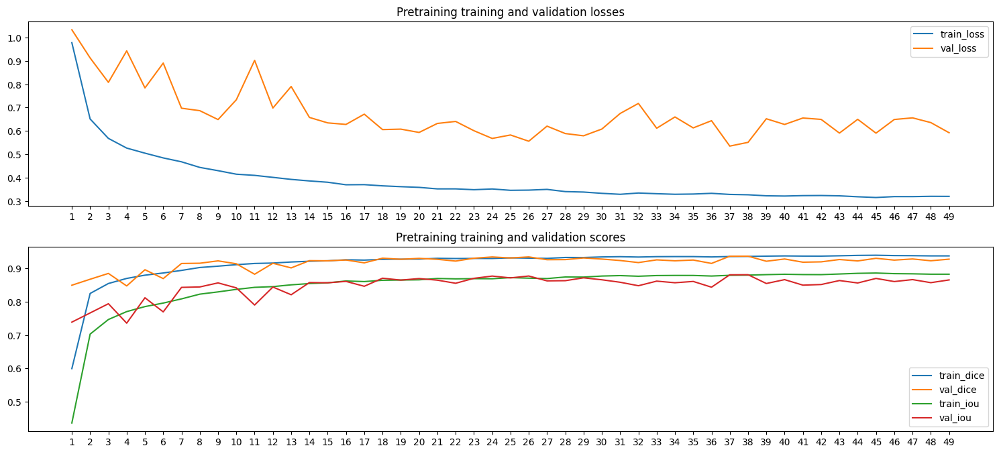

In [33]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(pretrain_train_losses, label="train_loss"); plt.title("Pretraining training and validation losses"); plt.plot(pretrain_val_train_losses, label="val_loss"); plt.legend()
plt.xticks(range(len(pretrain_train_losses)), range(1, len(pretrain_train_losses)+1))

plt.subplot(3,1,2); plt.plot(pretrain_dice_scores, label="train_dice"); plt.title("Pretraining training and validation scores"); plt.plot(pretrain_val_dice_scores, label="val_dice");
plt.plot(pretrain_iou_scores, label="train_iou"); plt.plot(pretrain_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(pretrain_val_iou_scores)), range(1, len(pretrain_val_iou_scores)+1))
plt.tight_layout()
plt.show()

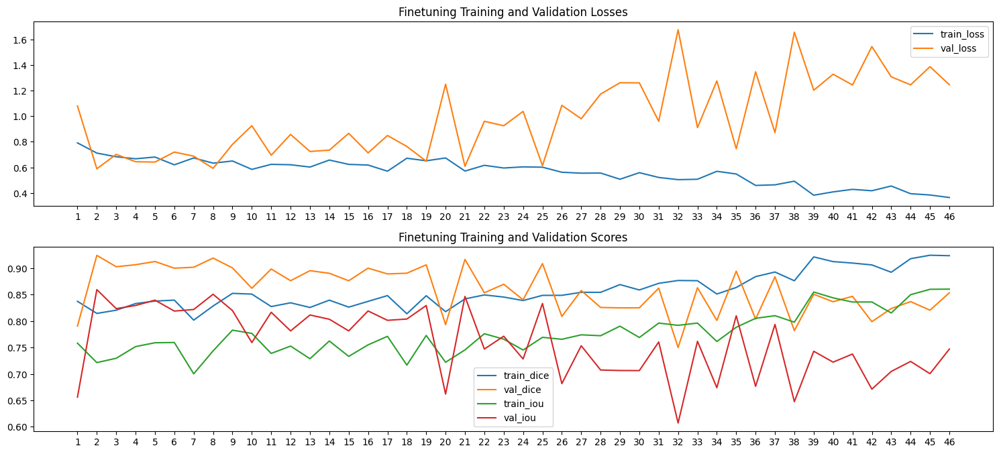

In [34]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(finetune_train_losses, label="train_loss"); plt.title("Finetuning Training and Validation Losses"); plt.plot(finetune_val_train_losses, label="val_loss");
plt.xticks(range(len(finetune_val_train_losses)), range(1, len(finetune_val_train_losses)+1))
plt.legend()

plt.subplot(3,1,2); plt.plot(finetune_dice_scores, label="train_dice"); plt.title("Finetuning Training and Validation Scores"); plt.plot(finetune_val_dice_scores, label="val_dice");
plt.plot(finetune_iou_scores, label="train_iou"); plt.plot(finetune_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(finetune_dice_scores)), range(1, len(finetune_dice_scores)+1))
plt.tight_layout()
plt.show()

In [35]:
loss = nn.BCEWithLogitsLoss()
test_loss, test_dice, test_iou = test(model=model, dataloader=test_loader, epoch=1, device=device, BCE=loss)

  0%|          | 0/9 [00:00<?, ?it/s]

Test Epoch: 1 | Loss: 0.8237 | Dice: 0.8807 | IoU: 0.7885


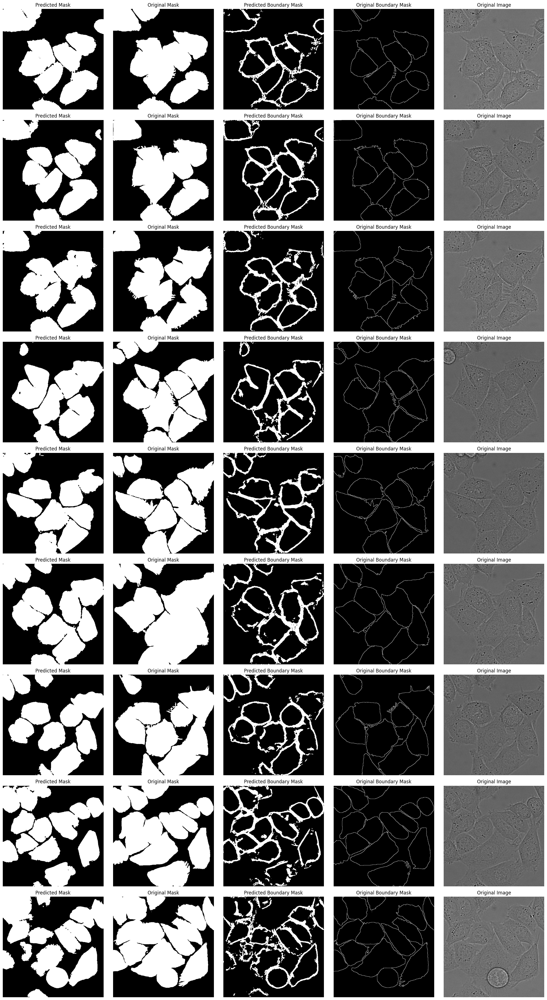

In [39]:
model.eval()
fig, axes = plt.subplots(nrows=len(test_loader), ncols=5, figsize=(20, 4*len(test_loader)))

with torch.inference_mode():
    for idx, (img, mask, boundary) in enumerate(test_loader):
        img_cpu = img.squeeze().cpu().numpy()
        mask_cpu = mask.squeeze().cpu().numpy()
        boundary = boundary.squeeze().cpu().numpy()
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze(dim=0).cpu().numpy()).astype(float)

        pred_mask = pred_cpu[0]
        pred_boundary = pred_cpu[1]
        pred_mask = (pred_mask > 0.5).astype(np.uint8) * 255
        pred_boundary = (pred_boundary > 0.5).astype(np.uint8) * 255


        # Predicted mask
        axes[idx, 0].imshow(pred_mask, cmap="gray")
        axes[idx, 0].set_title("Predicted Mask")
        axes[idx, 0].axis("off")

        # Ground truth mask
        axes[idx, 1].imshow(mask_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Mask")
        axes[idx, 1].axis("off")

        # Predicted Boundary
        axes[idx, 2].imshow(pred_boundary, cmap="gray")
        axes[idx, 2].set_title("Predicted Boundary Mask")
        axes[idx, 2].axis("off")

        # Ground truth Boundary
        axes[idx, 3].imshow(boundary, cmap="gray")
        axes[idx, 3].set_title("Original Boundary Mask")
        axes[idx, 3].axis("off")

        # Original image
        axes[idx, 4].imshow(img_cpu, cmap="gray")
        axes[idx, 4].set_title("Original Image")
        axes[idx, 4].axis("off")

plt.tight_layout()
plt.show()


In [37]:
import pandas as pd

pretrain_metrics = pd.DataFrame({
    "pretrain_train_loss": pretrain_train_losses,
    "pretrain_val_loss": pretrain_val_train_losses,
    "pretrain_train_dice": pretrain_dice_scores,
    "pretrain_val_dice": pretrain_val_dice_scores,
    "pretrain_train_iou": pretrain_iou_scores,
    "pretrain_val_iou": pretrain_val_iou_scores
})

finetune_metrics = pd.DataFrame({
    "finetune_train_loss": finetune_train_losses,
    "finetune_val_loss": finetune_val_train_losses,
    "finetune_train_dice": finetune_dice_scores,
    "finetune_val_dice": finetune_val_dice_scores,
    "finetune_train_iou": finetune_iou_scores,
    "finetune_val_iou": finetune_val_iou_scores
})

pretrain_metrics.to_csv("drive/MyDrive/models/pretrain_metrics_with_boundary.csv", index=False)
finetune_metrics.to_csv("drive/MyDrive/models/finetune_metrics_with_boundary.csv", index=False)

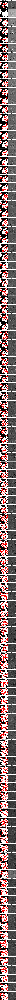

In [42]:
model.eval()
fig, axes = plt.subplots(nrows=len(final_test_loader_02), ncols=2, figsize=(8, 4*len(final_test_loader_02)))
pred_masks = []
test_images = []
with torch.inference_mode():
    for idx, (img) in enumerate(final_test_loader_02):
        img_cpu = img.squeeze().cpu().numpy()
        test_images.append(img_cpu.astype(np.uint8))
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze().cpu().numpy() > 0.5).astype(float)

        pred_mask = pred_cpu[0].astype(np.uint8) * 255
        pred_mask_rgb = np.stack([pred_mask,pred_mask,pred_mask], axis=-1)

        pred_boundary = pred_cpu[1].astype(np.uint8) * 255

        pred_mask_rgb[pred_boundary > 0] = [0,0,255]

        pred_masks.append(pred_mask_rgb)
        # Predicted mask
        axes[idx, 0].imshow(cv2.cvtColor(pred_mask_rgb, cv2.COLOR_BGR2RGB))
        axes[idx, 0].set_title("Predicted Mask with Boundary")
        axes[idx, 0].axis("off")

        # Original image
        axes[idx, 1].imshow(img_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Image")
        axes[idx, 1].axis("off")

plt.tight_layout()
plt.show()


In [48]:
import cv2

def get_binary_mask(model, img, device):
    img = test_transform(img)
    with torch.inference_mode():
        mask = torch.sigmoid(model(img.to(device))).squeeze().cpu().detach().numpy() > 0.5
    return mask[0].astype(np.uint8) * 255

def opening(mask, kernel):
    return cv2.dilate(cv2.erode(mask, kernel), kernel)

def closing(mask, kernel):
    return cv2.erode(cv2.dilate(mask, kernel), kernel)

def get_ith_image_from_dataloader(dataloader, i, device="cpu"):
    batch_size = dataloader.batch_size
    batch_idx = i // batch_size
    idx_in_batch = i % batch_size

    for b, (images) in enumerate(dataloader):
        if b == batch_idx:
            return images[idx_in_batch]


In [49]:
dataloader = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=None)
image = get_ith_image_from_dataloader(dataloader, 56, device).unsqueeze(dim=0)
image.shape


torch.Size([1, 1, 512, 512])

In [52]:
def unsharp(image, k=1.0, sigma=1.5):
    blur = cv2.GaussianBlur(image.astype(np.float32), (9,9), sigma)

    mask = image - blur

    sharp = image + k * mask

    sharp = np.clip(sharp, 0, 255).astype(np.uint8)

    return sharp

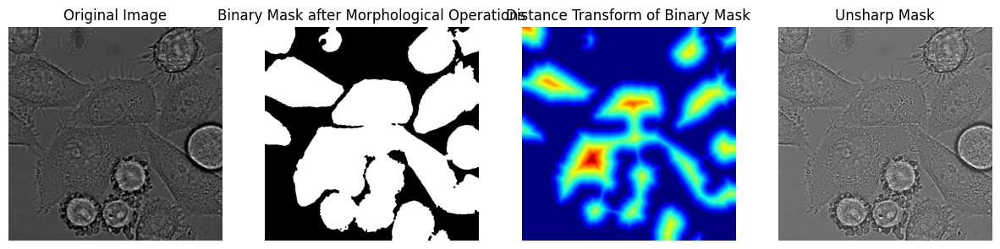

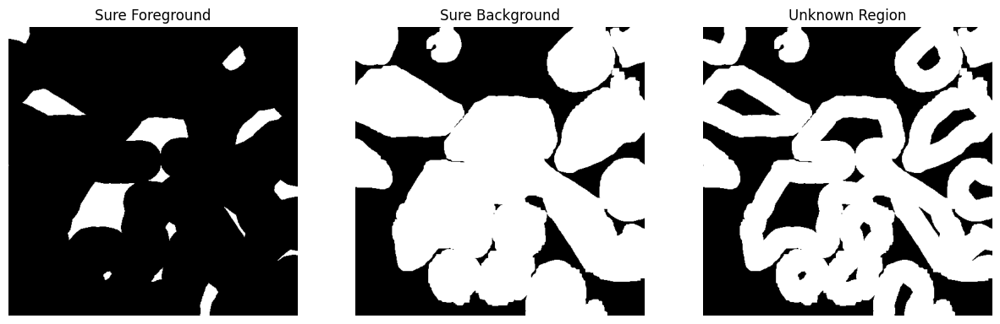

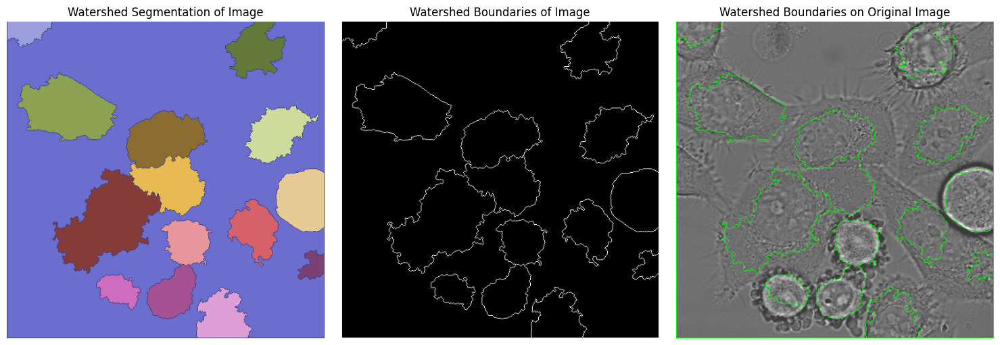

In [ ]:
unsharp_flag = True
kernel = np.ones((3,3), np.uint8)

image_cpu = (((image.squeeze().cpu().detach().numpy())) * 255).astype(np.uint8)

mask = get_binary_mask(model=model, device=device, img=image)
mask = opening(mask, kernel)
mask = closing(mask, kernel)
mask = mask.astype(np.uint8) * 255


dist = cv2.distanceTransform(mask, cv2.DIST_L2, 5)



k = 0.5
_, sure_fg = cv2.threshold(dist, k*dist.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
sure_bg = cv2.dilate(mask, kernel, iterations=3)
unknown = cv2.subtract(sure_bg, sure_fg)




_, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 1] = 0


img = np.stack([image_cpu,image_cpu,image_cpu], axis=-1)
rgb = img.copy()
figs = 3
if unsharp_flag:
  rgb = unsharp(rgb)
  figs = 4

markers = cv2.watershed(rgb, markers)

img[markers == -1] = [0,255,0]

plt.figure(figsize=(15,5))
plt.subplot(1,figs,1); plt.imshow(image_cpu, cmap="gray"); plt.axis("off");plt.title("Original Image")
plt.subplot(1,figs,2); plt.imshow(mask, cmap="gray"); plt.axis("off");plt.title("Binary Mask after Morphological Operations")
plt.subplot(1,figs,3);plt.imshow(dist, cmap="jet"); plt.axis("off");plt.title("Distance Transform of Binary Mask")
if unsharp_flag:

  plt.subplot(1,figs,4);plt.imshow(rgb); plt.axis("off");plt.title("Unsharp Mask")
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(sure_fg, cmap="gray"); plt.axis("off");plt.title("Sure Foreground")
plt.subplot(1,3,2); plt.imshow(sure_bg, cmap="gray"); plt.axis("off");plt.title("Sure Background")
plt.subplot(1,3,3);plt.imshow(unknown, cmap="gray"); plt.axis("off");plt.title("Unknown Region")
plt.show()

plt.figure(figsize=(15,5));plt.subplot(1,3,1);plt.imshow(markers, cmap="tab20b");plt.axis("off");plt.title(f"Watershed Segmentation of Image");
plt.subplot(1,3,2);plt.imshow(markers == -1, cmap="gray");plt.axis("off");plt.title(f"Watershed Boundaries of Image")


plt.subplot(1,3,3);plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB));plt.axis("off");plt.title(f"Watershed Boundaries on Original Image")

plt.tight_layout()
plt.show()


In [59]:
def img_to_video(out_path, vid_name, images, fps=24):
    full_path = out_path + vid_name

    first = images[0].copy()

    height, width = first.shape[:2]
    video = cv2.VideoWriter(full_path, cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

    for img in images:
        video.write(img)
    video.release()


In [60]:
img_to_video("./drive/MyDrive/videos/", "pred_masks_with_boundaries.mp4", pred_masks)
img_to_video("./drive/MyDrive/videos/", "test_images_with_boundaries.mp4", test_images)


In [ ]:
import cv2

In [ ]:
im = next(iter(pretrain_loader))[2].squeeze().numpy().astype(np.uint8)
kernel = np.ones((3,3), np.uint8)

im_e = cv2.erode(im, kernel, iterations=1)

im = im - im_e
plt.imshow(im > 0)